In [1]:
import os
import tarfile
import urllib.request

url = "http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar"


dataset_path = '/content/VOCtrainval_06-Nov-2007.tar'
if not os.path.exists(dataset_path):
    urllib.request.urlretrieve(url, dataset_path)
    print("Download complete!")


if os.path.exists(dataset_path):
    with tarfile.open(dataset_path, 'r') as file:
        file.extractall(path='/content')
    print("Extraction complete!")


Download complete!
Extraction complete!


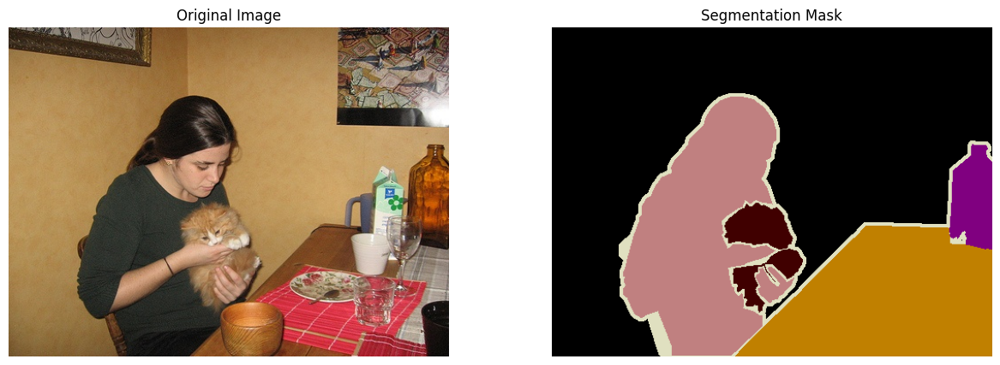

In [2]:
import matplotlib.pyplot as plt
from PIL import Image
import os

def load_image(image_path):
    return Image.open(image_path)

def display_images(images, titles=None, cmap=None, normalize=False):
    n = len(images)
    fig, axs = plt.subplots(1, n, figsize=(15, 5))
    for i, (img, ax) in enumerate(zip(images, axs)):

        if normalize:
            img = (img - img.min()) / (img.max() - img.min())
        ax.imshow(img, cmap=cmap)
        ax.axis('off')
        ax.set_title(titles[i])
    plt.show()


image_path = '/content/VOCdevkit/VOC2007/JPEGImages/001185.jpg'
mask_path = '/content/VOCdevkit/VOC2007/SegmentationClass/001185.png'

image = load_image(image_path)
mask = load_image(mask_path)

display_images([image, mask], titles=["Original Image", "Segmentation Mask"])


In [3]:
dir = '/content/VOCdevkit/VOC2007/SegmentationClass/'
count = 0
for i in os.listdir(dir):
  count += 1
count

422

In [4]:
import numpy as np
from sklearn.model_selection import train_test_split

trainval_path = '/content/VOCdevkit/VOC2007/ImageSets/Segmentation/trainval.txt'

with open(trainval_path,'r') as file:
  lines = file.read().splitlines()

train_val, test = train_test_split(lines, test_size=0.1, random_state=42)
train, val = train_test_split(train_val, test_size=0.1111, random_state=42)
len(val)

43

In [5]:
def image_mask_data(data, img_dir, mask_dir):
  images = []
  masks = []
  for i in data:
    img_loc = os.path.join(img_dir,i+'.jpg')
    mask_loc = os.path.join(mask_dir,i+'.png')
    images.append(img_loc)
    masks.append(mask_loc)
  return images,masks

In [6]:
base_img_path = '/content/VOCdevkit/VOC2007/JPEGImages'
base_mask_path = '/content/VOCdevkit/VOC2007/SegmentationClass'

# Load datasets
train_images, train_masks = image_mask_data(train, base_img_path, base_mask_path)
val_images, val_masks = image_mask_data(val, base_img_path, base_mask_path)
test_images, test_masks = image_mask_data(test, base_img_path, base_mask_path)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

Training set: 336 images
Validation set: 43 images
Test set: 43 images


In [7]:
def visualize_train(id):
  img = train_images[id]
  img = load_image(img)
  msk = train_masks[id]
  msk = load_image(msk)
  display_images([img, msk], titles=["Original Image", "Segmentation Mask"])


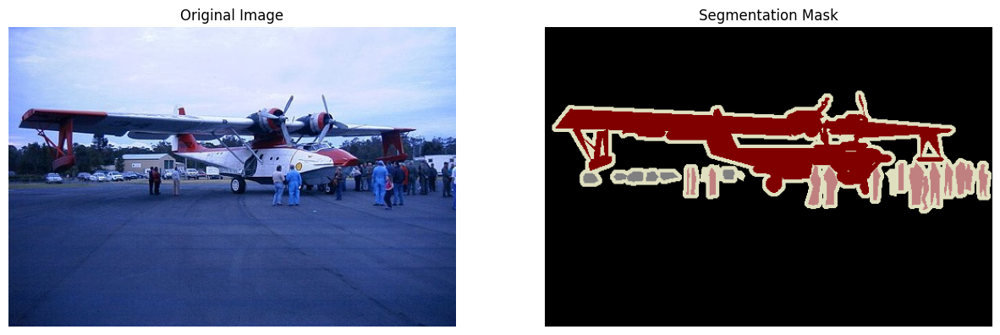

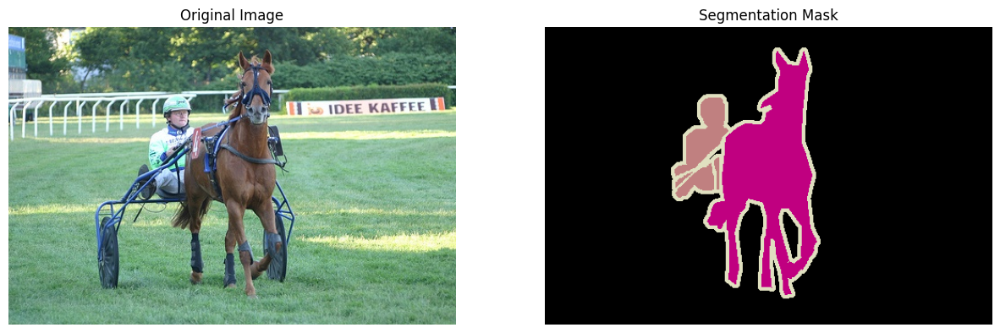

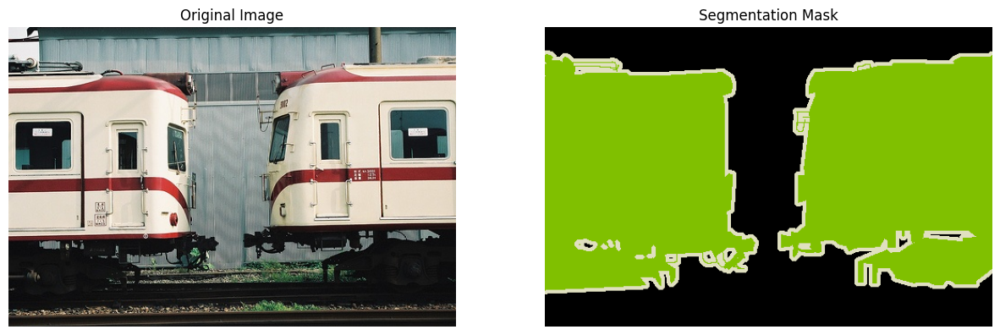

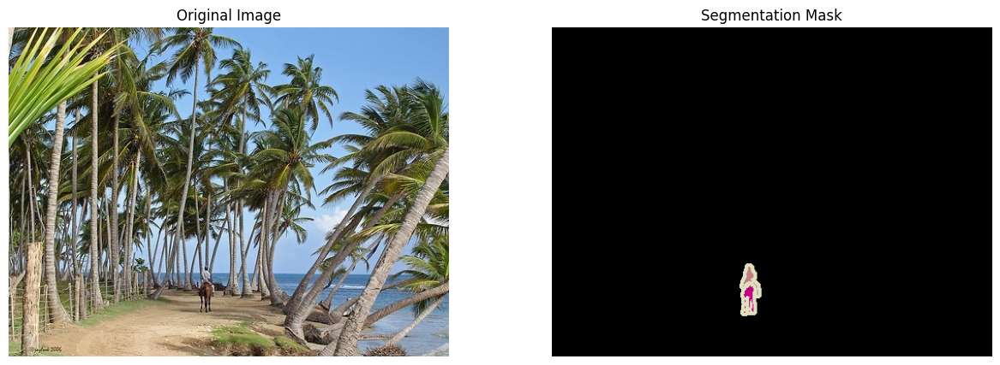

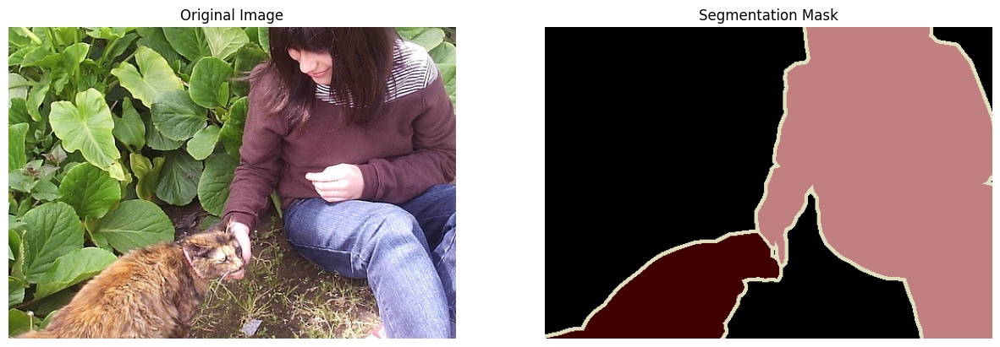

In [8]:
import random
for i in range(5):
  rand = random.randint(0,320)
  visualize_train(rand)

In [9]:
import torch
import numpy as np
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

# Color Map Function to Generate Unique Colors for Each Class
def color_map(N=256, normalized=False):
    def bitget(byteval, idx):
        return ((byteval & (1 << idx)) != 0)
    dtype = 'float32' if normalized else 'uint8'
    cmap = np.zeros((N, 3), dtype=dtype)
    for i in range(N):
        r = g = b = 0
        c = i
        for j in range(8):
            r = r | (bitget(c, 0) << 7-j)
            g = g | (bitget(c, 1) << 7-j)
            b = b | (bitget(c, 2) << 7-j)
            c = c >> 3
        cmap[i] = np.array([r, g, b])
    return cmap / 255 if normalized else cmap

cmap = color_map(N=22)

class PascalVOCDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None, target_transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform
        self.target_transform = target_transform
        self.cmap = color_map(N=22)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        mask = Image.open(self.mask_paths[idx]).convert("RGB")

        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            mask = self.target_transform(mask)

        mask = self.convert_color_to_labels(np.array(mask))
        return image, torch.tensor(mask, dtype=torch.float32)

    def convert_color_to_labels(self, mask):
        """ Convert an RGB mask to a 22-channel binary mask. """
        channels = np.zeros((22, *mask.shape[:2]), dtype=np.float32)
        for i, color in enumerate(self.cmap):
            channels[i] = np.all(mask == color, axis=-1)
        return channels

# Transformations
transform = transforms.Compose([transforms.Resize((224, 224)), transforms.ToTensor()])
target_transform = transforms.Compose([transforms.Resize((224, 224), interpolation=Image.NEAREST)])



In [10]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
# transform = A.Compose([
#     A.Resize(height=224,width=224),
#     A.Rotate(limit=35,p=1.0),
#     A.HorizontalFlip(p=0.5),
#     A.VerticalFlip(p=0.1),
#     A.Normalize(mean=[0.485, 0.456, 0.406],
#                          std=[0.229, 0.224, 0.225]),
#     ToTensorV2()

# ])

val_transform = A.Compose([

    A.Resize(height=224,width=224),  # Resize all images and masks to 224x224          # Convert images and masks to PyTorch tensors
    A.Normalize(mean=[0.485, 0.456, 0.406],  # Standard normalization for the images
                         std=[0.229, 0.224, 0.225]),
    ToTensorV2()
])

In [11]:
train_transform = transforms.Compose([
    transforms.Resize((224, 224), interpolation=Image.NEAREST),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

In [12]:
train_dataset = PascalVOCDataset(train_images, train_masks, transform=transform,target_transform=target_transform)
val_dataset = PascalVOCDataset(val_images, val_masks, transform=transform,target_transform=target_transform)
test_dataset = PascalVOCDataset(test_images, test_masks, transform=transform, target_transform=target_transform)


In [13]:
train_dataset[0][1].shape
count = 0
for i in train_dataset[10][1]:
  print(i)
  break

tensor([[1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        ...,
        [1., 1., 1.,  ..., 0., 0., 0.],
        [1., 1., 1.,  ..., 0., 0., 0.],
        [1., 1., 1.,  ..., 0., 0., 0.]])


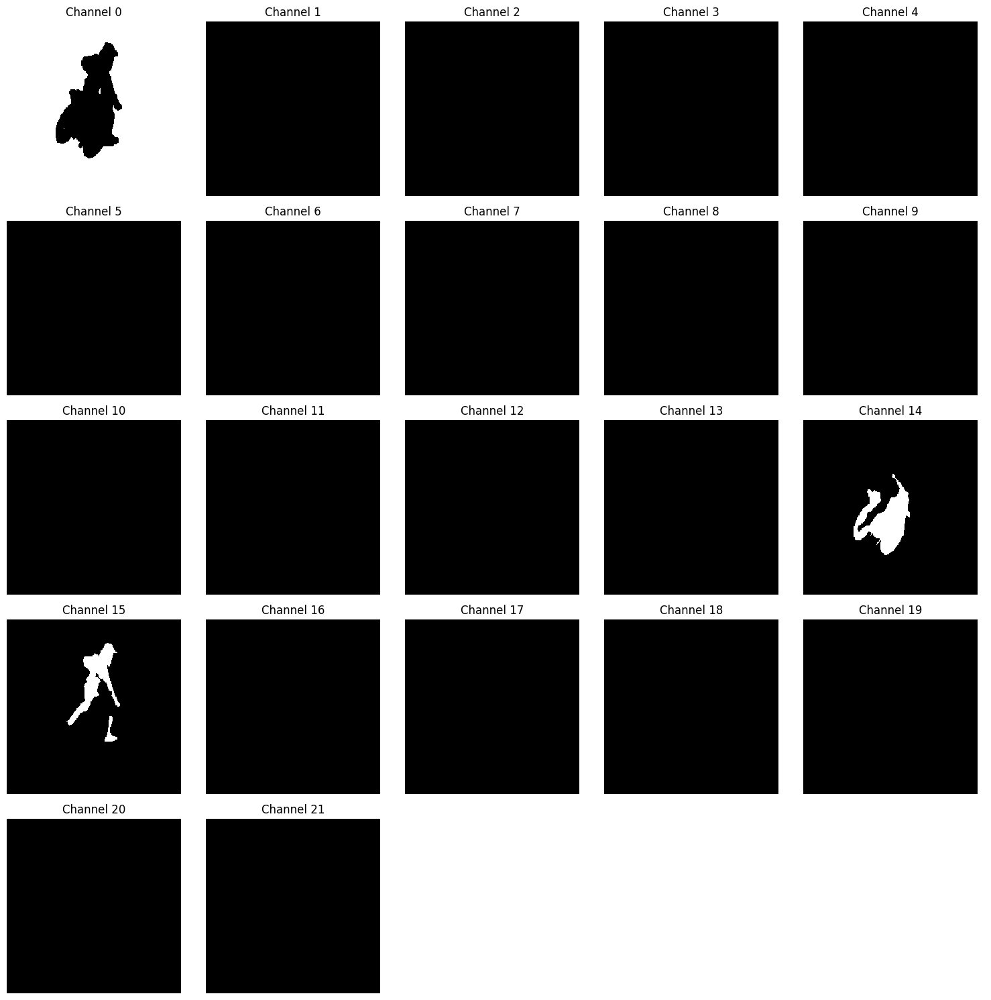

In [37]:
import matplotlib.pyplot as plt

def visualize_channels(mask_tensor, num_channels=22, rows=5):

    cols = (num_channels + rows - 1) // rows

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    axes = axes.flatten()

    for i in range(num_channels):

        if i < len(axes):
            if len(mask_tensor[1][i].shape) == 3:
                axes[i].imshow(mask_tensor[1][i].permute(1, 2, 0))
            else:  # If channel is 2D (HxW)
                axes[i].imshow(mask_tensor[1][i], cmap='gray', interpolation='none')
            axes[i].set_title(f'Channel {i}')
            axes[i].axis('off')
        else:
            break


    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


mask_tensor = train_dataset[220]
visualize_channels(mask_tensor)




In [38]:
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)

In [39]:
img,labels = next(iter(train_loader))
labels.shape

torch.Size([8, 22, 224, 224])

In [40]:
import torch
import torch.nn as nn
from tqdm import tqdm
import torch.optim as optim
import torchvision.transforms.functional as TF

In [18]:
class twoConv(nn.Module):
  def __init__(self,in_channel,out_channel):
    super(twoConv,self).__init__()
    self.conv = nn.Sequential(

        nn.Conv2d(in_channel,out_channel,3,1,1, bias = False),
        nn.BatchNorm2d(out_channel),
        nn.ReLU(inplace=True), # the input tensor will be overwritten with the ReLU operation
        nn.Conv2d(out_channel,out_channel,3,1,1,bias=False),
        nn.BatchNorm2d(out_channel),
        nn.ReLU(inplace=True),
    )

  def forward(self,x):
    return self.conv(x)


In [19]:
class UNet(nn.Module):
  def __init__(self, in_channel=3, out_channel=22, features=[64,128,256,512]):
    super(UNet,self).__init__()
    self.ups = nn.ModuleList()
    self.downs = nn.ModuleList()
    self.pool = nn.MaxPool2d(kernel_size=2,stride=2)

    # Down Part of UNet
    for feature in features:
      self.downs.append(twoConv(in_channel,feature))
      in_channel = feature

    # Upsampling part
    for feature in reversed(features):
      self.ups.append(nn.ConvTranspose2d(feature*2,feature,kernel_size=2,stride=2))
      self.ups.append(twoConv(feature*2,feature))

    self.bottleneck = twoConv(features[-1],features[-1]*2)
    self.final_conv = nn.Conv2d(features[0], out_channel,kernel_size=1)

  def forward(self,x):
    skip_connections = []
    for down in self.downs:
      x = down(x)
      skip_connections.append(x)
      x = self.pool(x)

    x = self.bottleneck(x)
    skip_connections = skip_connections[::-1]

    for idx in range(0,len(self.ups),2):
      x = self.ups[idx](x)
      skip_connection = skip_connections[idx//2]
      if x.shape != skip_connection.shape:
        x = TF.resize(x,size=skip_connection.shape[2:])
      concat_skip = torch.cat((skip_connection,x),dim=1)
      x = self.ups[idx+1](concat_skip)
    return self.final_conv(x)

In [20]:
# New UNET Model

import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""

    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels , in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])

        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class UNetnew(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(UNetnew, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256, bilinear)
        self.up2 = Up(512, 128, bilinear)
        self.up3 = Up(256, 64, bilinear)
        self.up4 = Up(128, 64, bilinear)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits


In [21]:
import torch.nn.functional as F
class DiceLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):


        inputs = F.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice = (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)

        return 1 - dice

class CombinedLoss(torch.nn.Module):
    def __init__(self, alpha=0.5, beta=0.5):
        super(CombinedLoss, self).__init__()
        self.alpha = alpha
        self.beta = beta
        self.dice_loss = DiceLoss()
        self.cross_entropy_loss = torch.nn.CrossEntropyLoss()

    def forward(self, inputs, targets):
        dice_loss = self.dice_loss(inputs, targets)
        cross_entropy_loss = self.cross_entropy_loss(inputs, targets)
        return self.alpha * dice_loss + self.beta * cross_entropy_loss

class ForegroundDiceLoss(torch.nn.Module):
    def __init__(self, smooth=1e-6):
        super(ForegroundDiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, inputs, targets):

        inputs = inputs[:, 1:, :, :]
        targets = targets[:, 1:, :, :]

        intersection = (inputs * targets).sum(dim=(2, 3))
        total = (inputs + targets).sum(dim=(2, 3))
        dice = (2.*intersection + self.smooth) / (total + self.smooth)

        return 1 - dice.mean()


In [24]:

batch_size = 16
num_epochs = 50
image_height = 224
image_width = 224
if torch.cuda.is_available():
  device = 'cuda'
else:
  device = 'cpu'

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = UNetnew(n_channels=3, n_classes=22).to(device)

loss_fn = CombinedLoss(alpha=0.5, beta=0.5)
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [25]:
from torch.utils.tensorboard import SummaryWriter


writer = SummaryWriter('runs/UNETTensorboard')


scaler = torch.cuda.amp.GradScaler()
for epoch in range(num_epochs):
    loop = tqdm(train_loader)

    for batch_idx, (data, targets) in enumerate(loop):
        data = data.to(device)
        targets = targets.float().to(device)


        with torch.cuda.amp.autocast():
            predictions = model(data)
            loss = loss_fn(predictions, targets)

        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        writer.add_scalar('Training loss', loss.item(), epoch * len(train_loader) + batch_idx)


        loop.set_postfix(loss=loss.item())

writer.close()


100%|██████████| 42/42 [00:18<00:00,  2.29it/s, loss=0.5]


In [26]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

In [36]:
import torch
import numpy as np

def dice_coefficient(pred, target):
    """Compute the Dice Coefficient."""
    smooth = 1e-6
    intersection = (pred * target).sum()
    return (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)

def evaluate_model(loader, model, device='cuda'):
    model.eval()
    total_dice = 0.0
    count = 0

    with torch.no_grad():
        for x, y in loader:
            x = x.to(device)
            y = y.to(device)
            y_pred = torch.sigmoid(model(x))
            y_pred = (y_pred > 0.5).float()

            for i in range(y_pred.shape[0]):
                for j in range(y_pred.shape[1]):
                    dice_score = dice_coefficient(y_pred[i, j], y[i, j])
                    total_dice += dice_score
                    count += 1

    average_dice = total_dice / count if count != 0 else 0
    return average_dice

# Example usage:
device = "cuda" if torch.cuda.is_available() else "cpu"
average_dice = evaluate_model(test_loader, model, device=device)
print(f'Average Dice Score across the dataset: {average_dice:.4f}')


Average Dice Score across the dataset: 0.8751


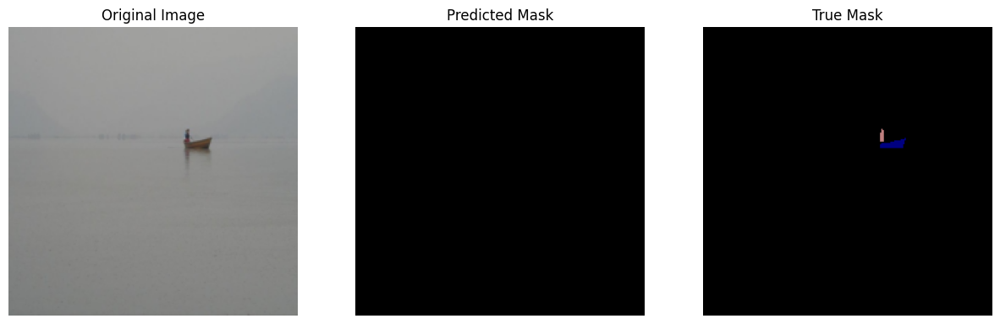

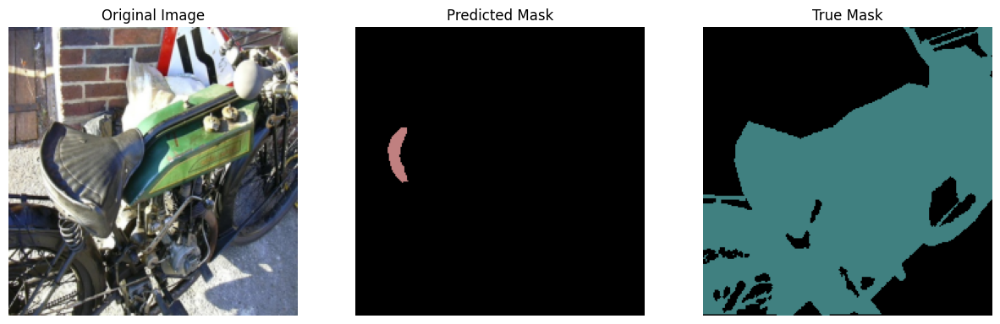

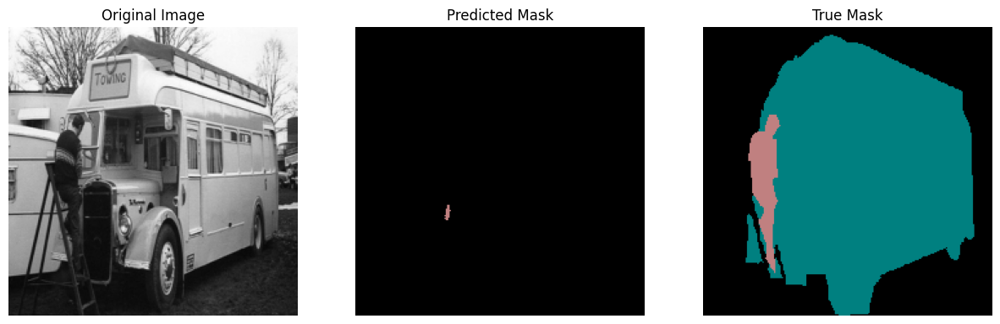

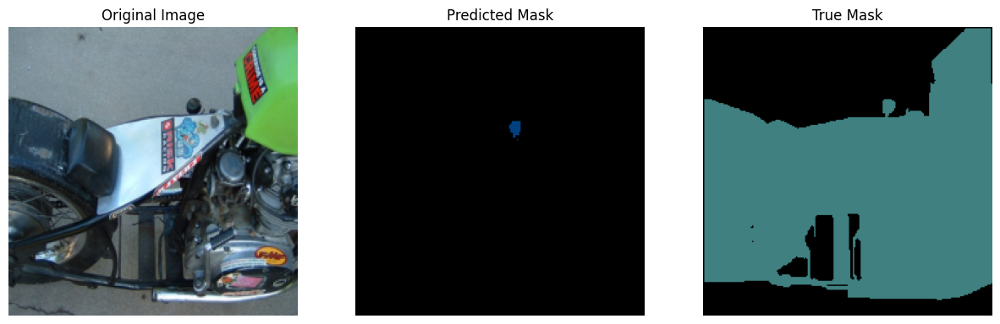

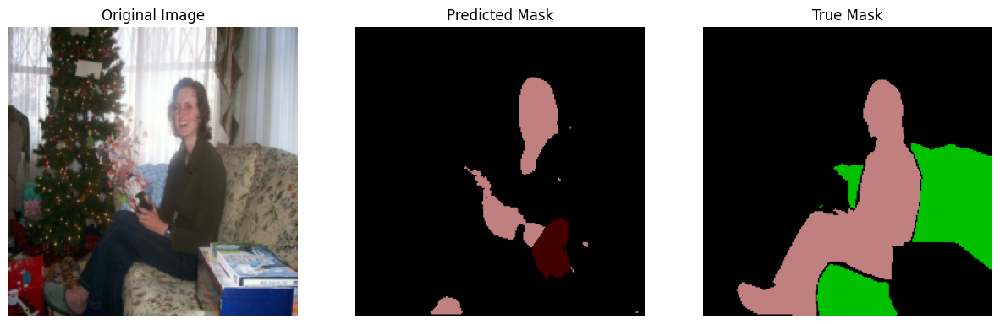

...

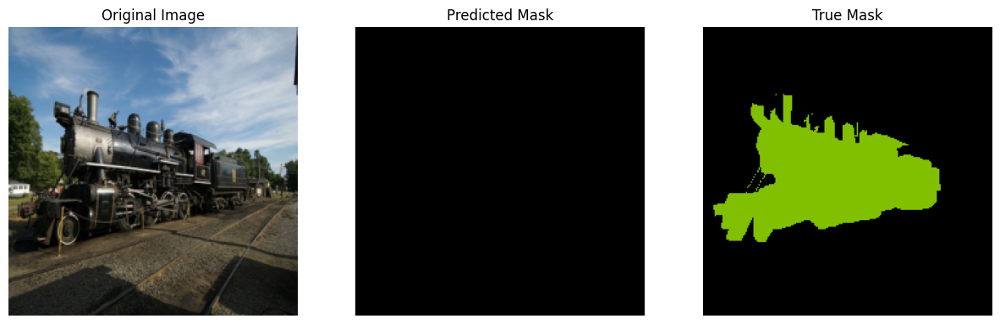

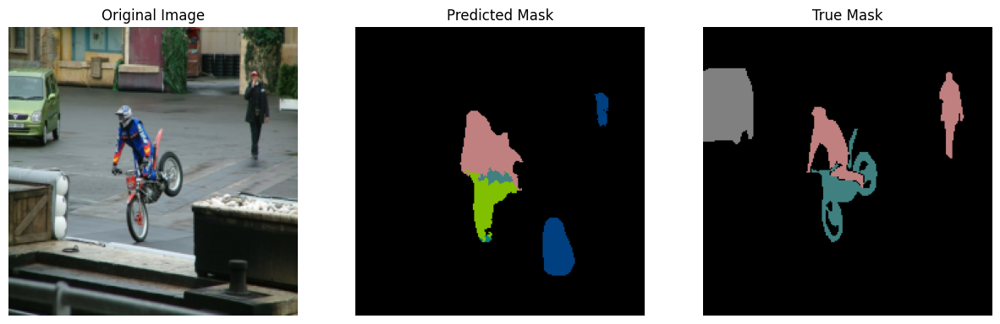

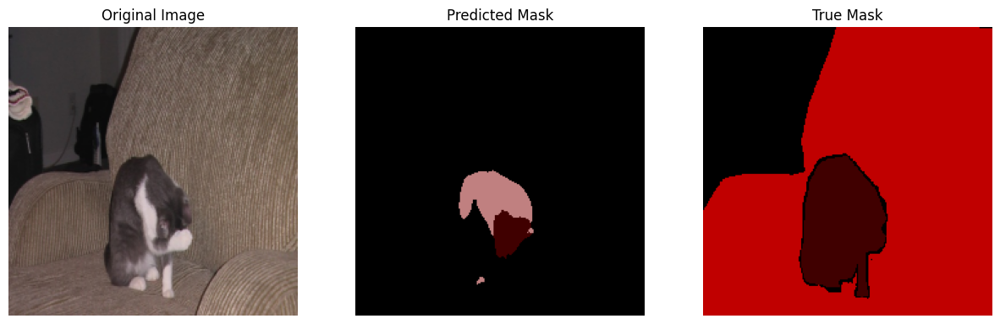

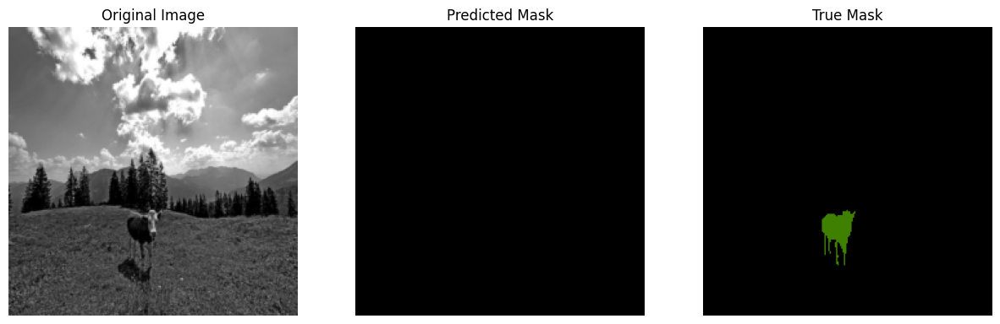

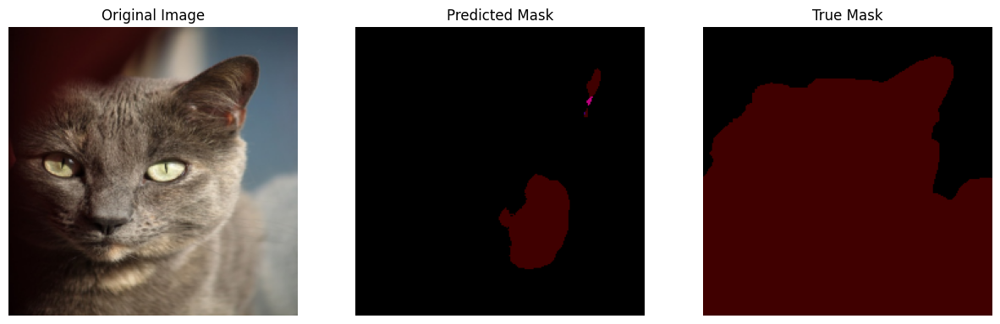

In [27]:
import torch
import matplotlib.pyplot as plt
import numpy as np


def decode_segmap(image, cmap):
    """Convert a 2D mask of labels into an RGB image using a colormap."""
    nc = len(cmap)
    r = np.zeros_like(image, dtype=np.uint8)
    g = np.zeros_like(image, dtype=np.uint8)
    b = np.zeros_like(image, dtype=np.uint8)

    for l in range(nc):
        idx = image == l
        r[idx] = cmap[l, 0]
        g[idx] = cmap[l, 1]
        b[idx] = cmap[l, 2]

    rgb = np.stack([r, g, b], axis=2)
    return rgb

model.eval()

with torch.no_grad():
    for images, true_masks in val_loader:
        images = images.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        preds = preds.cpu().numpy()
        images = images.cpu().numpy()

        if true_masks.dim() == 4 and true_masks.shape[1] == 22:
            true_masks = true_masks.argmax(dim=1)
        true_masks = true_masks.cpu().numpy()

        for img, pred, t_mask in zip(images, preds, true_masks):
            img = np.transpose(img, (1, 2, 0))
            img = (img * 255).astype(np.uint8)  # Adjust based on your normalization
            pred_rgb = decode_segmap(pred, cmap)
            true_rgb = decode_segmap(t_mask, cmap)

            fig, ax = plt.subplots(1, 3, figsize=(15, 5))
            ax[0].imshow(img)
            ax[0].set_title('Original Image')
            ax[1].imshow(pred_rgb)
            ax[1].set_title('Predicted Mask')
            ax[2].imshow(true_rgb)
            ax[2].set_title('True Mask')
            for a in ax:
                a.axis('off')
            plt.show()

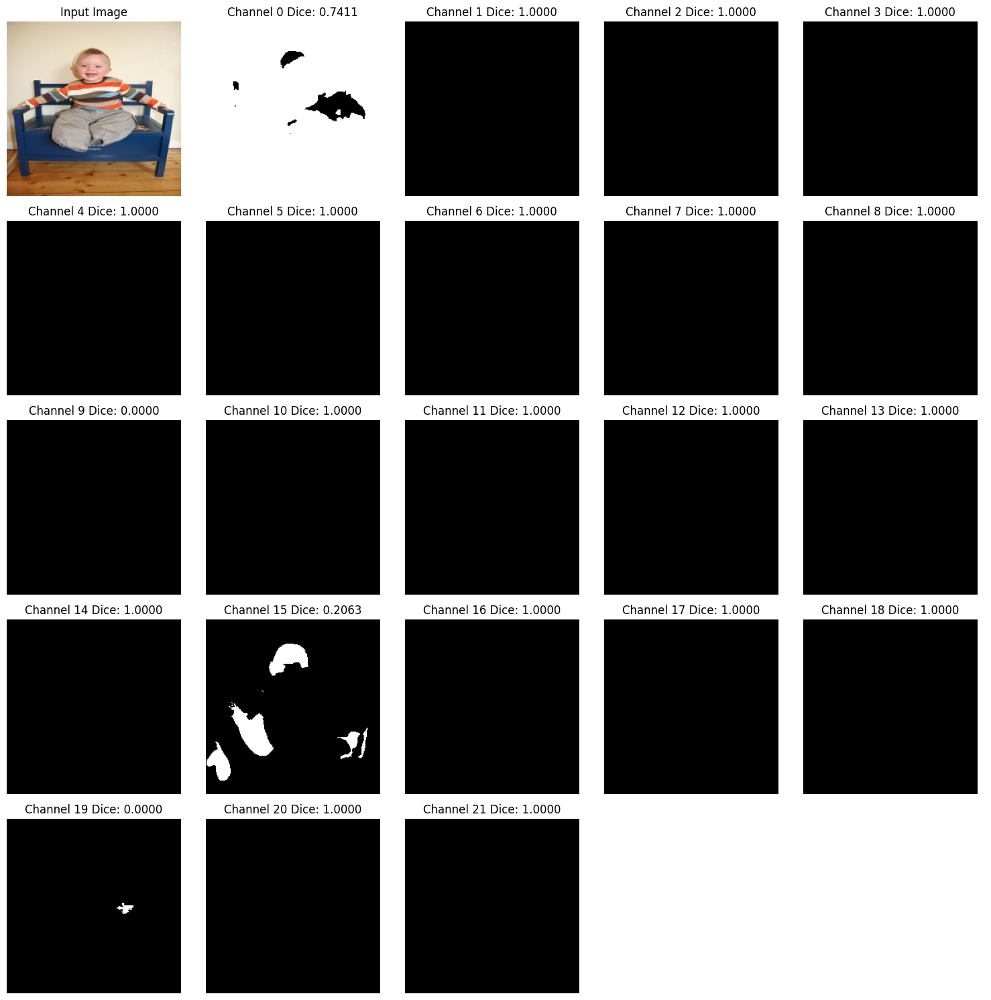

In [35]:
import matplotlib.pyplot as plt
import torch
import numpy as np

def dice_coefficient(pred, target):
    """Compute the Dice Coefficient."""
    smooth = 1e-6
    intersection = (pred * target).sum()
    return (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)

def visualize_and_evaluate(loader, model, device='cuda', sample_index=0):
    model.eval()  # Set the model to evaluation mode
    with torch.no_grad():
        x, y = next(iter(loader))
        x = x.to(device)
        y_pred = torch.sigmoid(model(x))
        y_pred = (y_pred > 0.5).float()

    num_channels = y_pred.shape[1]
    cols = 5
    rows = (num_channels + cols) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    axes = axes.flatten()


    input_image = x[sample_index].cpu().detach().permute(1, 2, 0)
    if input_image.shape[2] == 1:
        input_image = input_image.squeeze()
    axes[0].imshow(input_image, cmap='gray')
    axes[0].set_title('Input Image')
    axes[0].axis('off')

    dice_scores = []

    for i in range(num_channels):
        prediction = y_pred[sample_index, i].cpu().detach()
        true_mask = y[sample_index, i].cpu()
        dice_score = dice_coefficient(prediction, true_mask)
        dice_scores.append(dice_score)

        axes[i + 1].imshow(prediction, cmap='gray')
        axes[i + 1].set_title(f'Channel {i} Dice: {dice_score:.4f}')
        axes[i + 1].axis('off')

    for j in range(num_channels + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

    return dice_scores

device = "cuda" if torch.cuda.is_available() else "cpu"
dice_scores = visualize_and_evaluate(test_loader, model, device=device, sample_index=7)
